In [1]:
from urllib import request
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()


In [2]:
#request.urlretrieve ("https://s3-eu-west-1.amazonaws.com/static.oc-static.com/prod/courses/files/AI+Engineer/Project+2+Participez+%C3%A0+un+concours+sur+la+Smart+City/p2-arbres-fr.csv", "p2-arbres-fr.csv")
P2Arbresfr = pd.read_csv("p2-arbres-fr.csv", sep=";" )

In [3]:
#********************************************************************
#*           la présentation générale du jeu de données             *
#********************************************************************

In [4]:
P2Arbresfr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200137 entries, 0 to 200136
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   200137 non-null  int64  
 1   type_emplacement     200137 non-null  object 
 2   domanialite          200136 non-null  object 
 3   arrondissement       200137 non-null  object 
 4   complement_addresse  30902 non-null   object 
 5   numero               0 non-null       float64
 6   lieu                 200137 non-null  object 
 7   id_emplacement       200137 non-null  object 
 8   libelle_francais     198640 non-null  object 
 9   genre                200121 non-null  object 
 10  espece               198385 non-null  object 
 11  variete              36777 non-null   object 
 12  circonference_cm     200137 non-null  int64  
 13  hauteur_m            200137 non-null  int64  
 14  stade_developpement  132932 non-null  object 
 15  remarquable      

In [5]:
P2Arbresfr.describe()

,id,numero,circonference_cm,hauteur_m,remarquable,geo_point_2d_a,geo_point_2d_b
count,2.001370e+05,0.0,200137.000000,200137.000000,137039.000000,200137.000000,200137.000000
mean,3.872027e+05,NaN,83.380479,13.110509,0.001343,48.854491,2.348208
std,5.456032e+05,NaN,673.190213,1971.217387,0.036618,0.030234,0.051220
min,9.987400e+04,NaN,0.000000,0.000000,0.000000,48.742290,2.210241
25%,1.559270e+05,NaN,30.000000,5.000000,0.000000,48.835021,2.307530
50%,2.210780e+05,NaN,70.000000,8.000000,0.000000,48.854162,2.351095
75%,2.741020e+05,NaN,115.000000,12.000000,0.000000,48.876447,2.386838
max,2.024745e+06,NaN,250255.000000,881818.000000,1.000000,48.911485,2.469759


In [6]:
#Permet d'obtenir la somme des NaN pour les 18 colonnes.
P2Arbresfr.isna().sum()

id                          0
type_emplacement            0
domanialite                 1
arrondissement              0
complement_addresse    169235
numero                 200137
lieu                        0
id_emplacement              0
libelle_francais         1497
genre                      16
espece                   1752
variete                163360
circonference_cm            0
hauteur_m                   0
stade_developpement     67205
remarquable             63098
geo_point_2d_a              0
geo_point_2d_b              0
dtype: int64

In [7]:
#Calcul du pourcentage par colonnes des NaN
PourcentNaN=((P2Arbresfr.isna().sum()*100)/200137)

In [8]:
#Pourcentage par colonnes des NaN
PourcentNaN

id                       0.000000
type_emplacement         0.000000
domanialite              0.000500
arrondissement           0.000000
complement_addresse     84.559577
numero                 100.000000
lieu                     0.000000
id_emplacement           0.000000
libelle_francais         0.747988
genre                    0.007995
espece                   0.875400
variete                 81.624088
circonference_cm         0.000000
hauteur_m                0.000000
stade_developpement     33.579498
remarquable             31.527404
geo_point_2d_a           0.000000
geo_point_2d_b           0.000000
dtype: float64

In [9]:
P2Arbresfr

,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,NaN,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,NaN,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,NaN,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,NaN,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,NaN,38,0,NaN,NaN,48.890435,2.315289
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200132,2024741,Arbre,Jardin,BOIS DE VINCENNES,NaN,NaN,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170151,NaN,Castanea,fargesii,NaN,0,0,NaN,0.0,48.821957,2.456264
200133,2024742,Arbre,Jardin,BOIS DE VINCENNES,NaN,NaN,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170152,Arbre aux mouchoirs,Davidia,involucrata,NaN,0,0,NaN,0.0,48.823254,2.457935
200134,2024743,Arbre,Jardin,BOIS DE VINCENNES,NaN,NaN,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170153,Peuplier,Populus,simonii,NaN,0,0,NaN,0.0,48.822907,2.457970
200135,2024744,Arbre,Jardin,BOIS DE VINCENNES,NaN,NaN,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170154,Chêne,Quercus,n. sp.,NaN,0,0,NaN,0.0,48.822522,2.455956


In [10]:
#********************************************************************
#*         la démarche méthodologique d’analyse de données          *
#********************************************************************

In [11]:
#Suppression des colonnes inutilisables 
P2Arbresfr = P2Arbresfr.drop(columns=["complement_addresse"])
P2Arbresfr = P2Arbresfr.drop(columns=["numero"])
P2Arbresfr = P2Arbresfr.drop(columns=["variete"])

In [12]:
P2Arbresfr

,id,type_emplacement,domanialite,arrondissement,lieu,id_emplacement,libelle_francais,genre,espece,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,38,0,NaN,NaN,48.890435,2.315289
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200132,2024741,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170151,NaN,Castanea,fargesii,0,0,NaN,0.0,48.821957,2.456264
200133,2024742,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170152,Arbre aux mouchoirs,Davidia,involucrata,0,0,NaN,0.0,48.823254,2.457935
200134,2024743,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170153,Peuplier,Populus,simonii,0,0,NaN,0.0,48.822907,2.457970
200135,2024744,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170154,Chêne,Quercus,n. sp.,0,0,NaN,0.0,48.822522,2.455956


In [13]:
MoyHauteur = P2Arbresfr.hauteur_m.mean()
MoyHauteur

13.110509301128728

In [14]:
P2Arbresfr.hauteur_m.replace(0, MoyHauteur)

0          5.000000
1          8.000000
2         10.000000
3          8.000000
4         13.110509
            ...    
200132    13.110509
200133    13.110509
200134    13.110509
200135    13.110509
200136    13.110509
Name: hauteur_m, Length: 200137, dtype: float64

In [15]:
P2Arbresfr.hauteur_m=P2Arbresfr.hauteur_m.replace(0, MoyHauteur)

In [16]:
MoyCirconference = P2Arbresfr.circonference_cm.mean()
print (MoyCirconference)

83.38047937163043


In [17]:
P2Arbresfr.circonference_cm.replace(0, MoyCirconference)

0         20.000000
1         65.000000
2         90.000000
3         60.000000
4         38.000000
            ...    
200132    83.380479
200133    83.380479
200134    83.380479
200135    83.380479
200136    83.380479
Name: circonference_cm, Length: 200137, dtype: float64

In [18]:
P2Arbresfr.circonference_cm=P2Arbresfr.circonference_cm.replace(0, MoyCirconference)

In [19]:
#Suppression des valeurs aberrantes basée sur un multiple des quantiles de la distribution
q1_hauteur_m = P2Arbresfr.hauteur_m.quantile(0.25)
q3_hauteur_m = P2Arbresfr.hauteur_m.quantile(0.75)
iqr_hauteur_m = q3_hauteur_m - q1_hauteur_m
seuil_max_hauteur_m = q3_hauteur_m + 1.5*iqr_hauteur_m
seuil_max_hauteur_m

22.276273252821817

In [20]:
masqueH = P2Arbresfr["hauteur_m"] > seuil_max_hauteur_m
masqueH

0         False
1         False
2         False
3         False
4         False
          ...  
200132    False
200133    False
200134    False
200135    False
200136    False
Name: hauteur_m, Length: 200137, dtype: bool

In [21]:
masqueH.sum()

3903

In [22]:
masqueH2 = P2Arbresfr["hauteur_m"] < seuil_max_hauteur_m
P2Arbresfr = P2Arbresfr[masqueH2]

In [23]:
#Suppression des valeurs aberrantes basée sur un multiple des quantiles de la distribution
q1_circonference_cm = P2Arbresfr.circonference_cm.quantile(0.25)
q3_circonference_cm = P2Arbresfr.circonference_cm.quantile(0.75)
iqr_circonference_cm = q3_circonference_cm - q1_circonference_cm
seuil_max_circonference_cm = q3_circonference_cm + 1.5*iqr_circonference_cm
seuil_max_circonference_cm

200.0

In [24]:
masqueC = P2Arbresfr["circonference_cm"] > seuil_max_circonference_cm
masqueC

0         False
1         False
2         False
3         False
4         False
          ...  
200132    False
200133    False
200134    False
200135    False
200136    False
Name: circonference_cm, Length: 196234, dtype: bool

In [25]:
masqueC.sum()

6511

In [26]:
masqueC2 = P2Arbresfr["circonference_cm"] < seuil_max_circonference_cm
P2Arbresfr = P2Arbresfr[masqueC2]

In [27]:
P2Arbresfr

,id,type_emplacement,domanialite,arrondissement,lieu,id_emplacement,libelle_francais,genre,espece,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,20.000000,5.000000,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,65.000000,8.000000,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,90.000000,10.000000,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,60.000000,8.000000,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,38.000000,13.110509,NaN,NaN,48.890435,2.315289
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200132,2024741,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170151,NaN,Castanea,fargesii,83.380479,13.110509,NaN,0.0,48.821957,2.456264
200133,2024742,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170152,Arbre aux mouchoirs,Davidia,involucrata,83.380479,13.110509,NaN,0.0,48.823254,2.457935
200134,2024743,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170153,Peuplier,Populus,simonii,83.380479,13.110509,NaN,0.0,48.822907,2.457970
200135,2024744,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170154,Chêne,Quercus,n. sp.,83.380479,13.110509,NaN,0.0,48.822522,2.455956


In [28]:
P2Arbresfr.describe(include="all")

,id,type_emplacement,domanialite,arrondissement,lieu,id_emplacement,libelle_francais,genre,espece,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
count,1.886080e+05,188608,188607,188608,188608,188608,187138,188592,186862,188608.000000,188608.000000,123500,128129.000000,188608.000000,188608.000000
unique,NaN,1,9,25,6829,65741,192,175,537,NaN,NaN,4,NaN,NaN,NaN
top,NaN,Arbre,Alignement,PARIS 15E ARRDT,PARC FLORAL DE PARIS / ROUTE DE LA PYRAMIDE,101001,Platane,Platanus,x hispanica,NaN,NaN,A,NaN,NaN,NaN
freq,NaN,188608,99956,16724,2677,1244,37244,37316,32379,NaN,NaN,59869,NaN,NaN,NaN
mean,3.871621e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.216612,10.378789,NaN,0.000406,48.854603,2.347913
std,5.447023e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,42.094428,4.168356,NaN,0.020141,0.030210,0.051358
min,9.987400e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,NaN,0.000000,48.742290,2.210241
25%,1.568978e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.000000,7.000000,NaN,0.000000,48.835099,2.307098
50%,2.214095e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.380479,10.000000,NaN,0.000000,48.854048,2.350707
75%,2.741632e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,105.000000,13.110509,NaN,0.000000,48.876481,2.386917


In [29]:
P2Arbresfr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 188608 entries, 0 to 200136
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   188608 non-null  int64  
 1   type_emplacement     188608 non-null  object 
 2   domanialite          188607 non-null  object 
 3   arrondissement       188608 non-null  object 
 4   lieu                 188608 non-null  object 
 5   id_emplacement       188608 non-null  object 
 6   libelle_francais     187138 non-null  object 
 7   genre                188592 non-null  object 
 8   espece               186862 non-null  object 
 9   circonference_cm     188608 non-null  float64
 10  hauteur_m            188608 non-null  float64
 11  stade_developpement  123500 non-null  object 
 12  remarquable          128129 non-null  float64
 13  geo_point_2d_a       188608 non-null  float64
 14  geo_point_2d_b       188608 non-null  float64
dtypes: float64(5), in

In [30]:
P2Arbresfr.hauteur_m.min()

1.0

In [31]:
P2Arbresfr.hauteur_m.max()

22.0

In [32]:
P2Arbresfr.circonference_cm.min()

1.0

In [33]:
P2Arbresfr.circonference_cm.max()

199.0

In [34]:
#Conversion circonferance cm en m
P2Arbresfr.circonference_cm = P2Arbresfr.circonference_cm/100.0
P2Arbresfr=P2Arbresfr.rename(columns={"circonference_cm":"circonference_m"})

In [35]:
P2Arbresfr

,id,type_emplacement,domanialite,arrondissement,lieu,id_emplacement,libelle_francais,genre,espece,circonference_m,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,0.200000,5.000000,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,0.650000,8.000000,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,0.900000,10.000000,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,0.600000,8.000000,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,0.380000,13.110509,NaN,NaN,48.890435,2.315289
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200132,2024741,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170151,NaN,Castanea,fargesii,0.833805,13.110509,NaN,0.0,48.821957,2.456264
200133,2024742,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170152,Arbre aux mouchoirs,Davidia,involucrata,0.833805,13.110509,NaN,0.0,48.823254,2.457935
200134,2024743,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170153,Peuplier,Populus,simonii,0.833805,13.110509,NaN,0.0,48.822907,2.457970
200135,2024744,Arbre,Jardin,BOIS DE VINCENNES,ARBORETUM DE L ECOLE DU BREUIL - ROUTE DE LA F...,720170154,Chêne,Quercus,n. sp.,0.833805,13.110509,NaN,0.0,48.822522,2.455956


In [36]:
P2Arbresfr.describe()

,id,circonference_m,hauteur_m,remarquable,geo_point_2d_a,geo_point_2d_b
count,1.886080e+05,188608.000000,188608.000000,128129.000000,188608.000000,188608.000000
mean,3.871621e+05,0.822166,10.378789,0.000406,48.854603,2.347913
std,5.447023e+05,0.420944,4.168356,0.020141,0.030210,0.051358
min,9.987400e+04,0.010000,1.000000,0.000000,48.742290,2.210241
25%,1.568978e+05,0.500000,7.000000,0.000000,48.835099,2.307098
50%,2.214095e+05,0.833805,10.000000,0.000000,48.854048,2.350707
75%,2.741632e+05,1.050000,13.110509,0.000000,48.876481,2.386917
max,2.024745e+06,1.990000,22.000000,1.000000,48.911485,2.469759


In [37]:
P2Arbresfr.max()

id                             2024745
type_emplacement                 Arbre
arrondissement            VAL-DE-MARNE
lieu                YEO THOMAS (5) MAT
id_emplacement                Q9630006
circonference_m                   1.99
hauteur_m                           22
remarquable                          1
geo_point_2d_a                 48.9115
geo_point_2d_b                 2.46976
dtype: object

In [38]:
#********************************************************************
#*            la synthèse de votre analyse de données               *
#********************************************************************

In [39]:
#Moyennes
P2Arbresfr.mean()


id                 387162.085617
circonference_m         0.822166
hauteur_m              10.378789
remarquable             0.000406
geo_point_2d_a         48.854603
geo_point_2d_b          2.347913
dtype: float64

In [40]:
#Variances
P2Arbresfr.var()

id                 2.967006e+11
circonference_m    1.771941e-01
hauteur_m          1.737519e+01
remarquable        4.056794e-04
geo_point_2d_a     9.126632e-04
geo_point_2d_b     2.637665e-03
dtype: float64

In [41]:
#Ecarts-types
P2Arbresfr.std()

id                 544702.304760
circonference_m         0.420944
hauteur_m               4.168356
remarquable             0.020141
geo_point_2d_a          0.030210
geo_point_2d_b          0.051358
dtype: float64

Diagramme secteurs de la domanialité

Nous observons environ 50% des arbres sont alignés certainement pour ombrager la voirie.
Nous observons environ 25% des arbres sont dans les jardins et que la répartition domaniale 
est inégale pour les domanialités restantes.
 


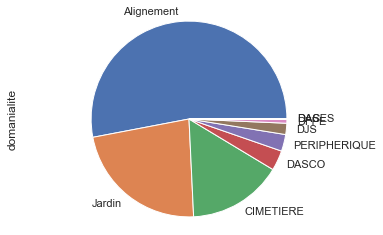

In [42]:
print ('Diagramme secteurs de la domanialité\n')
print('Nous observons environ 50% des arbres sont alignés certainement pour ombrager la voirie.')
print('Nous observons environ 25% des arbres sont dans les jardins et que la répartition domaniale ')
print('est inégale pour les domanialités restantes.\n ')
# Diagramme en secteurs
P2Arbresfr["domanialite"].value_counts(normalize=True).plot(kind='pie')
# Cette ligne assure que le pie chart est un cercle plutôt qu'une éllipse
plt.axis('equal') 
plt.show() # Affiche le graphique

Diagramme barre horizontale arrondissement

Nous observons une répartition inégale des arbres par arrondissement.



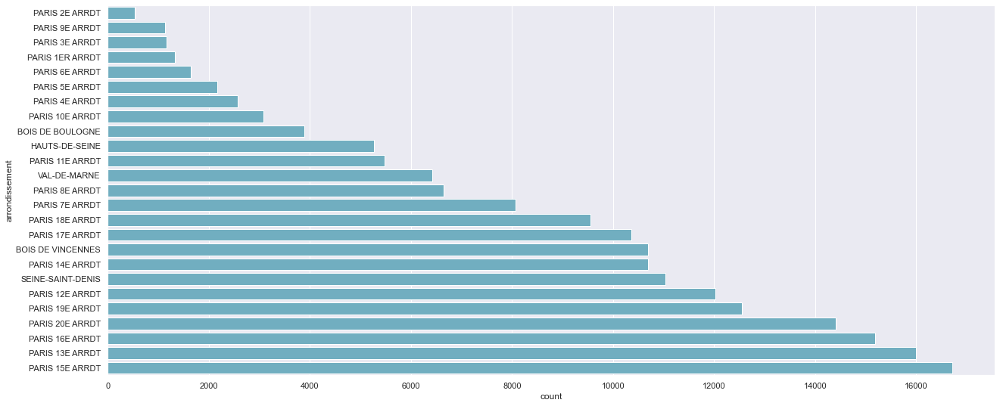

In [43]:
print ('Diagramme barre horizontale arrondissement\n')
print('Nous observons une répartition inégale des arbres par arrondissement.\n')
f, ax = plt.subplots(figsize=(21, 9))
sns.countplot(y="arrondissement", data=P2Arbresfr, order=P2Arbresfr['arrondissement'].value_counts().sort_values().index, color="c");

Diagramme secteurs du stade de developpement

Nous observons environ 50% des arbres sont adultes.
Nous observons environ 25% des arbres sont des jeunes adultes et que la répartition du stade de developpement 
est inégale pour les stades de developpement restants. 


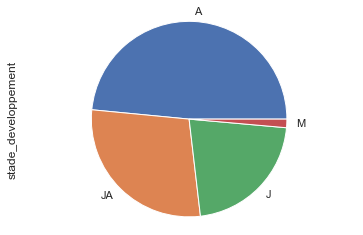

In [44]:
print ('Diagramme secteurs du stade de developpement\n')
print('Nous observons environ 50% des arbres sont adultes.')
print('Nous observons environ 25% des arbres sont des jeunes adultes et que la répartition du stade de developpement ')
print('est inégale pour les stades de developpement restants. ')
# Diagramme en secteurs
P2Arbresfr["stade_developpement"].value_counts(normalize=True).plot(kind='pie')
# Cette ligne assure que le pie chart est un cercle plutôt qu'une éllipse
plt.axis('equal') 
plt.show() # Affiche le graphique

Histogrames du stade de developpement par rapport à la hauteur analyse univariée

Boites à moustache de la hauteur

Nous observons qu il y a une répartition inégale du quantile  des arbres adultes qui sont beaucoup plus nombreux
par rapport aux autre stades de developpement.
--------------------
nan
moy:
 nan
med:
 nan
mod:
 Series([], dtype: float64)
var:
 nan
ect:
 nan
skw:
 nan
kur:
 nan


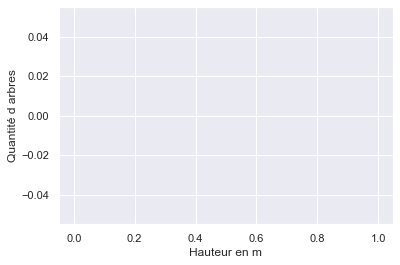

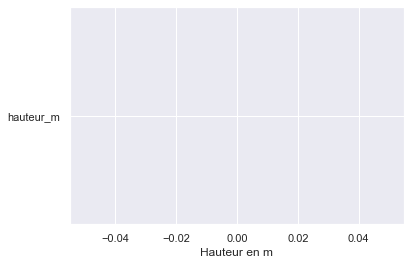

--------------------
A
moy:
 12.567680173473
med:
 12.0
mod:
 0    10.0
dtype: float64
var:
 14.918020832926
ect:
 3.8623853812023987
skw:
 0.14295157031344644
kur:
 -0.4139877074539693


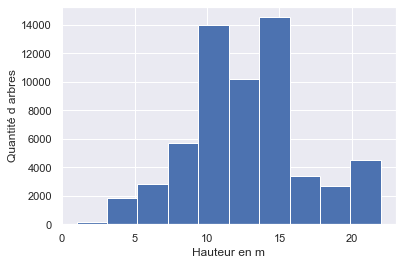

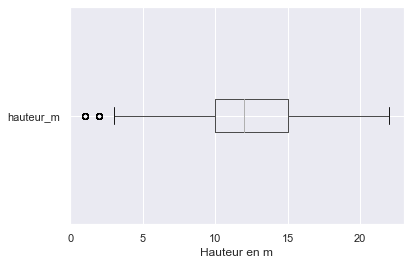

--------------------
J
moy:
 5.883440648370013
med:
 5.0
mod:
 0    5.0
dtype: float64
var:
 5.042992254798078
ect:
 2.2456607612901105
skw:
 1.3934202475976945
kur:
 3.002701233033332


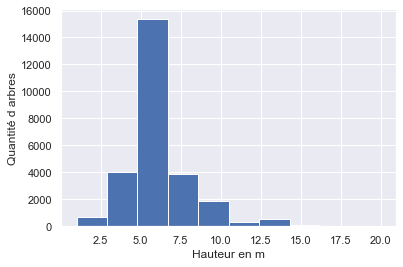

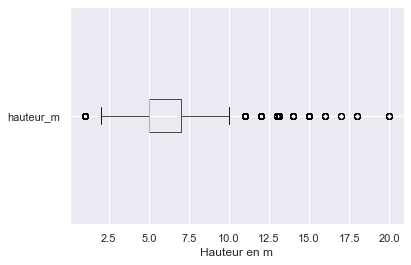

--------------------
M
moy:
 15.729949495527665
med:
 15.0
mod:
 0    20.0
dtype: float64
var:
 17.80991493215346
ect:
 4.220179490513817
skw:
 -0.6554974439425726
kur:
 -0.0896971411864027


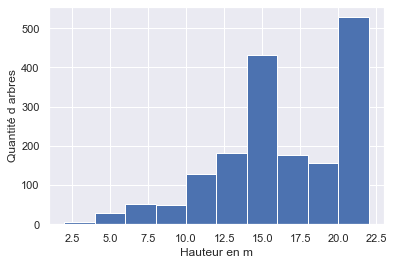

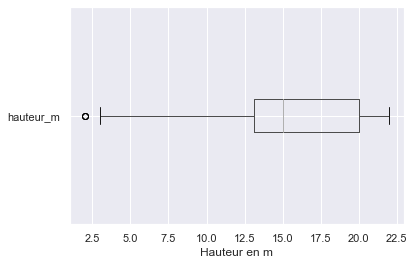

--------------------
JA
moy:
 9.094816464271036
med:
 10.0
mod:
 0    10.0
dtype: float64
var:
 10.151134860151899
ect:
 3.1860845657565178
skw:
 0.7130764403635985
kur:
 0.8196222557914963


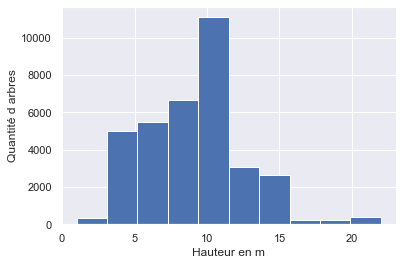

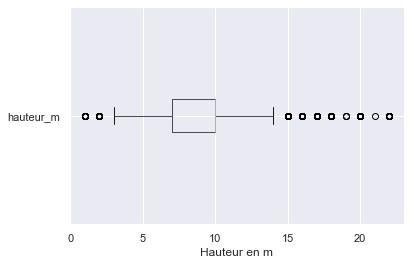

In [45]:
print ('Histogrames du stade de developpement par rapport à la hauteur analyse univariée\n')
print ('Boites à moustache de la hauteur\n')
print('Nous observons qu il y a une répartition inégale du quantile  des arbres adultes qui sont beaucoup plus nombreux')
print('par rapport aux autre stades de developpement.')

for cat in P2Arbresfr["stade_developpement"].unique():
    subset = P2Arbresfr[P2Arbresfr.stade_developpement == cat]
    print("-"*20)
    print(cat)
    print("moy:\n",subset['hauteur_m'].mean())
    print("med:\n",subset['hauteur_m'].median())
    print("mod:\n",subset['hauteur_m'].mode())
    print("var:\n",subset['hauteur_m'].var(ddof=0))
    print("ect:\n",subset['hauteur_m'].std(ddof=0))
    print("skw:\n",subset['hauteur_m'].skew())
    print("kur:\n",subset['hauteur_m'].kurtosis())
    subset["hauteur_m"].hist()
    plt.xlabel("Hauteur en m")
    plt.ylabel("Quantité d arbres")
    plt.show()
    subset.boxplot(column="hauteur_m", vert=False)
    plt.xlabel("Hauteur en m")
    plt.show()

Histogrames du stade de developpement par rapport à la hauteur analyse univariée

Boites à moustache de la hauteur

Nous observons qu il y a une répartition inégale du quantile  des arbres adultes qui sont beaucoup plus nombreux
par rapport aux autre stades de developpement.
--------------------
nan
moy:
 nan
med:
 nan
mod:
 Series([], dtype: float64)
var:
 nan
ect:
 nan
skw:
 nan
kur:
 nan


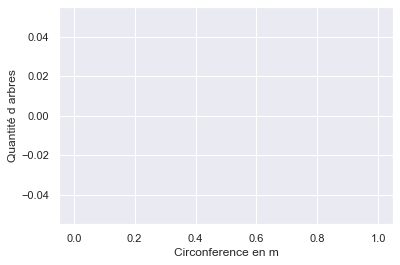

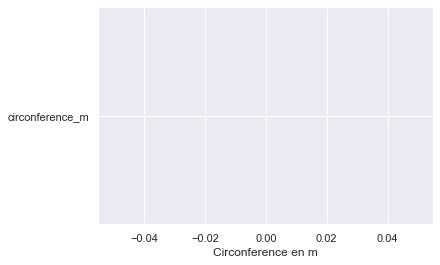

--------------------
A
moy:
 1.1516241826035305
med:
 1.1
mod:
 0    1.0
dtype: float64
var:
 0.1352899447044665
ect:
 0.3678178145556119
skw:
 0.12363471767203583
kur:
 -0.5679304443768229


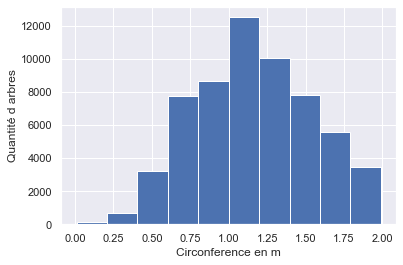

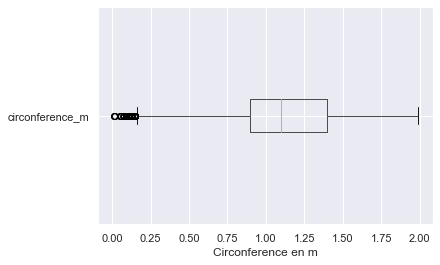

--------------------
J
moy:
 0.3876767003355059
med:
 0.35
mod:
 0    0.3
dtype: float64
var:
 0.033875574329344516
ect:
 0.1840531834262709
skw:
 1.461154330633572
kur:
 3.5446965139555355


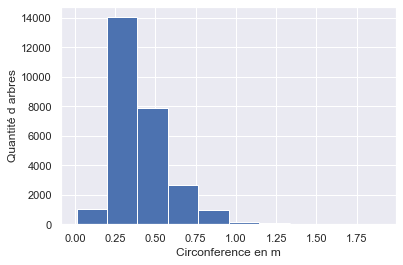

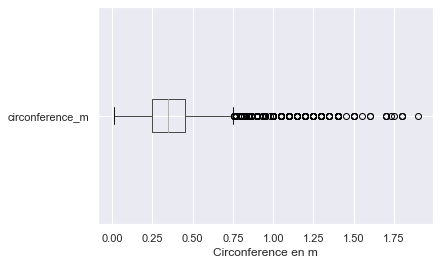

--------------------
M
moy:
 1.5543023649341066
med:
 1.65
mod:
 0    1.9
dtype: float64
var:
 0.1170569891902565
ect:
 0.34213592209859595
skw:
 -1.1990336654401128
kur:
 1.5042795273531526


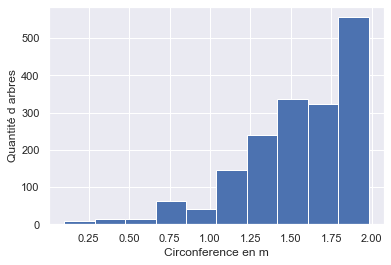

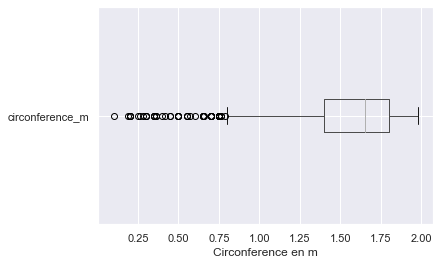

--------------------
JA
moy:
 0.702427133649496
med:
 0.66
mod:
 0    0.7
dtype: float64
var:
 0.06150234147563021
ect:
 0.24799665617832473
skw:
 0.8666861519628296
kur:
 1.3199743730923563


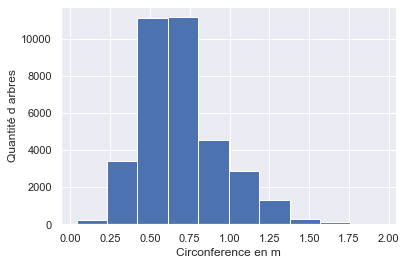

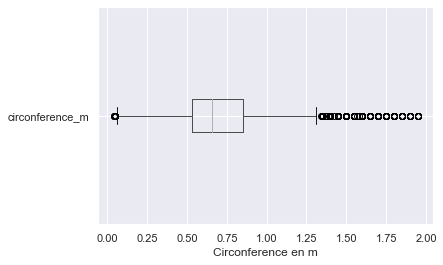

In [46]:
print ('Histogrames du stade de developpement par rapport à la hauteur analyse univariée\n')
print ('Boites à moustache de la hauteur\n')
print('Nous observons qu il y a une répartition inégale du quantile  des arbres adultes qui sont beaucoup plus nombreux')
print('par rapport aux autre stades de developpement.')

for cat in P2Arbresfr["stade_developpement"].unique():
    subset = P2Arbresfr[P2Arbresfr.stade_developpement == cat]
    print("-"*20)
    print(cat)
    print("moy:\n",subset['circonference_m'].mean())
    print("med:\n",subset['circonference_m'].median())
    print("mod:\n",subset['circonference_m'].mode())
    print("var:\n",subset['circonference_m'].var(ddof=0))
    print("ect:\n",subset['circonference_m'].std(ddof=0))
    print("skw:\n",subset['circonference_m'].skew())
    print("kur:\n",subset['circonference_m'].kurtosis())
    subset["circonference_m"].hist()
    plt.xlabel("Circonference en m")
    plt.ylabel("Quantité d arbres")    
    plt.show()
    subset.boxplot(column="circonference_m", vert=False)
    plt.xlabel("Circonference en m")    
    plt.show()

In [47]:
# frequency count of column arrondissement 
count = P2Arbresfr.arrondissement.value_counts() 
print(count) 

PARIS 15E ARRDT      16724
PARIS 13E ARRDT      15999
PARIS 16E ARRDT      15187
PARIS 20E ARRDT      14409
PARIS 19E ARRDT      12549
PARIS 12E ARRDT      12033
SEINE-SAINT-DENIS    11034
PARIS 14E ARRDT      10699
BOIS DE VINCENNES    10692
PARIS 17E ARRDT      10359
PARIS 18E ARRDT       9555
PARIS 7E ARRDT        8075
PARIS 8E ARRDT        6649
VAL-DE-MARNE          6420
PARIS 11E ARRDT       5485
HAUTS-DE-SEINE        5261
BOIS DE BOULOGNE      3887
PARIS 10E ARRDT       3084
PARIS 4E ARRDT        2564
PARIS 5E ARRDT        2168
PARIS 6E ARRDT        1637
PARIS 1ER ARRDT       1321
PARIS 3E ARRDT        1158
PARIS 9E ARRDT        1128
PARIS 2E ARRDT         531
Name: arrondissement, dtype: int64


In [48]:
P2Arbresfr.describe()

,id,circonference_m,hauteur_m,remarquable,geo_point_2d_a,geo_point_2d_b
count,1.886080e+05,188608.000000,188608.000000,128129.000000,188608.000000,188608.000000
mean,3.871621e+05,0.822166,10.378789,0.000406,48.854603,2.347913
std,5.447023e+05,0.420944,4.168356,0.020141,0.030210,0.051358
min,9.987400e+04,0.010000,1.000000,0.000000,48.742290,2.210241
25%,1.568978e+05,0.500000,7.000000,0.000000,48.835099,2.307098
50%,2.214095e+05,0.833805,10.000000,0.000000,48.854048,2.350707
75%,2.741632e+05,1.050000,13.110509,0.000000,48.876481,2.386917
max,2.024745e+06,1.990000,22.000000,1.000000,48.911485,2.469759


In [49]:
each = 0

In [50]:
# Carte de SEINE-SAINT-DENIS
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'SEINE-SAINT-DENIS':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_mapSEINE-SAINT-DENIS.html')    
#display(map)

In [51]:
# Carte du BOIS DE VINCENNES
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'BOIS DE VINCENNES':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_mapBOIS DE VINCENNES.html')    
#display(map)


In [52]:
# Carte du VAL-DE-MARNE
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'VAL-DE-MARNE':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_mapVAL-DE-MARNE.html')    
#display(map)


In [53]:
# Carte des HAUTS-DE-SEINE
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'HAUTS-DE-SEINE':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_mapHAUTS-DE-SEINE.html')    
#display(map)


In [54]:
# Carte du BOIS DE BOULOGNE
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'BOIS DE BOULOGNE':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_mapBOIS DE BOULOGNE.html')    
#display(map)


In [55]:
# Carte de PARIS 1ER ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 1ER ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map1er.html')    
#display(map)


In [56]:
map

In [57]:
# Carte de PARIS 2E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 2E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map2eme.html')    
display(map)


In [58]:
# Carte de PARIS 3E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 3E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map3eme.html')    
#display(map)


In [59]:
# Carte de PARIS 4E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 4E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map4eme.html')    
#display(map)


In [60]:
# Carte de PARIS 5E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 5E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map5eme.html')    
#display(map)


In [61]:
# Carte de PARIS 6E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 6E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map6eme.html')    
#display(map)


In [62]:
# Carte de PARIS 7E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 7E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map7eme.html')    
#display(map)


In [63]:
# Carte de PARIS 8E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 8E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map8eme.html')    
#display(map)


In [64]:
# Carte de PARIS 9E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 9E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map9eme.html')    
#display(map)


In [65]:
# Carte de PARIS 10E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 10E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map10eme.html')    
#display(map)


In [66]:
# Carte de PARIS 11E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 11E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map11eme.html')    
#display(map)


In [67]:
# Carte de PARIS 12E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 12E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map12eme.html')    
#display(map)


In [68]:
# Carte de PARIS 13E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 13E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)
        




map.save(outfile='P2_01_map13eme.html')    
#display(map)


In [69]:
# Carte de PARIS 14E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 14E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map14eme.html')    
#display(map)


In [70]:
# Carte de PARIS 15E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 15E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map15eme.html')    
#display(map)


In [71]:
# Carte de PARIS 16E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 16E ARRDT':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map16eme.html')    
#display(map)


In [72]:
# Carte de PARIS 16E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 16E ARRDT' and each[1]['stade_developpement'] == 'A':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map16stade_developpementA.html')    
display(map)

In [73]:
# Carte de PARIS 16E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 16E ARRDT' and each[1]['stade_developpement'] == 'JA':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map16stade_developpementJA.html')    
display(map)

In [74]:
# Carte de PARIS 16E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 16E ARRDT' and each[1]['stade_developpement'] == 'J':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map16stade_developpementJ.html')    
display(map)

In [75]:
# Carte de PARIS 16E ARRDT
import folium

 
P_COORDINATES = (48.854491,2.348208)

 
# for speed purposes 
MAX_RECORDS = 200137
  
# create empty map zoomed in on Paris
map = folium.Map(location=P_COORDINATES, zoom_start=12)

# add a marker for every record in the filtered data, use a clustered view
for each in P2Arbresfr[0:MAX_RECORDS].iterrows():
    if each[1]['arrondissement'] == 'PARIS 16E ARRDT' and each[1]['stade_developpement'] == 'M':    
        folium.Marker(location = [each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b']], icon=folium.Icon(icon='cloud', color='green'), clustered_marker = True, popup = ['<b>Identifiant:</b>', each[1]['id'],'<b>Coordonnees_geographiques:</b>', each[1]['geo_point_2d_a'], each[1]['geo_point_2d_b'], '<b>Type_arbre:</b>', each[1]['libelle_francais'], '<b>Stade_developpement:</b>', each[1]['stade_developpement'], '<b>hauteur_m:</b>', each[1]['hauteur_m'], '<b>circonference_m:</b>', each[1]['circonference_m']]).add_to(map)





map.save(outfile='P2_01_map16stade_developpementM.html')    
display(map)